In [2]:
%matplotlib inline
from matplotlib import animation
import matplotlib.pyplot as plt

import gym, pickle,os,torch, time
from policies import *


In [3]:
# Run a demo of the environment
def get_train_policy(path, env, epochs=500):
    constraints_p = [f for f in os.listdir(path) if ("constraints.p" in f) ]
    constraints = pickle.load(open(path+constraints_p[-1],'rb'))["constraints"]
    
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    print('Using device:', device)
    
    policy = policies.Policy_quad(env.observation_space.shape[0], env.action_space.shape[0])
    policy.to(device)
    states, actions, rewards, info = zip(*constraints)
    policy.train(torch.tensor(states).float().to(device),
                torch.tensor(actions).float().to(device), epoch=epochs)
    return policy.cpu()
    
def getframes(policy, env):
    observation = env.reset()
    cum_reward = 0
    frames = []
    for t in range(1000):
        # Render into buffer. 
        fr = env.render(mode = 'rgb_array')
        print(fr)
        frames.append(fr)
        obs =  torch.from_numpy(observation).unsqueeze(0).float()
        action = policy(obs).detach().numpy()
        observation, reward, done, info = env.step(action)
        cum_reward += reward
        if done:
            break
    print("reward: %.3f" % cum_reward)
    return frames[:steps]

In [4]:
def play(policy, env):
    observation = env.reset()
    cum_reward = 0
    for t in range(1000):
        obs =  torch.from_numpy(observation).unsqueeze(0).float()
        action = policy(obs).detach().numpy()
        observation, reward, done, info = env.step(action)
        cum_reward += reward
        if done:
            break
    return cum_reward

In [5]:
def load_policy(path, env):
    model = Policy_quad(env.observation_space.shape[0],
                env.action_space.shape[0],
                num_hidden=24)
    model.load_state_dict(pickle.load(open(path, "rb" )))
    return model

In [45]:
path = "results/Hopper-v2/imitation-test-08_04_04_32/209_"
env = gym.make('Hopper-v2')
constraints = pickle.load( open( path+"constraints.p", "rb" ))
model = load_policy(path+"policy.p", env)

In [55]:

policy209 = Policy_quad(env.observation_space.shape[0],
                env.action_space.shape[0],
                num_hidden=24)
states = torch.Tensor([x[0] for x in constraints])
actions = torch.Tensor([x[1] for x in constraints])
policy209.train(states.to(device), actions.to(device), 10000)

Policy trianing: epoch 0, loss = 1.859
Policy trianing: epoch 500, loss = 0.061
Policy trianing: epoch 1000, loss = 0.062
Policy trianing: epoch 1500, loss = 0.047
Policy trianing: epoch 2000, loss = 0.030
Policy trianing: epoch 2500, loss = 0.038
Policy trianing: epoch 3000, loss = 0.029
Policy trianing: epoch 3500, loss = 0.024
Policy trianing: epoch 4000, loss = 0.036
Policy trianing: epoch 4500, loss = 0.024
Policy trianing: epoch 5000, loss = 0.023
Policy trianing: epoch 5500, loss = 0.032
Policy trianing: epoch 6000, loss = 0.025
Policy trianing: epoch 6500, loss = 0.023
Policy trianing: epoch 7000, loss = 0.022
Policy trianing: epoch 7500, loss = 0.019
Policy trianing: epoch 8000, loss = 0.028
Policy trianing: epoch 8500, loss = 0.023
Policy trianing: epoch 9000, loss = 0.024
Policy trianing: epoch 9500, loss = 0.025
max iter: epoch 9999, loss = 0.018


In [6]:
import matplotlib.pyplot as plt

In [48]:
ex210 = [tuple(x[0].tolist()) for x in constraints210]
ex209 = [tuple(x[0].tolist()) for x in constraints]
print(len(ex210))
print(len(ex209))
#print(len(set(ex210)))
print(len(set(ex210)-set(ex209)), len(set(ex209)-set(ex210)))

34522
34522
32276 32276


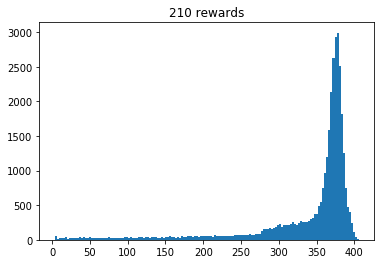

In [28]:
path = "results/Hopper-v2/imitation-test-08_04_04_32/210_"
constraints210 = pickle.load( open( path+"constraints.p", "rb" ))
plt.hist([s[-2] for s in constraints210], bins='auto')  # arguments are passed to np.histogram
plt.title("210 rewards")
plt.show()

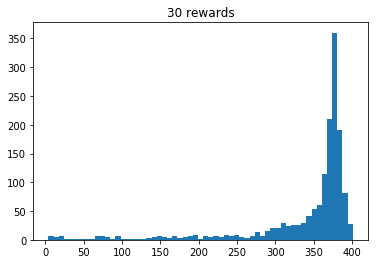

In [11]:
plt.hist([s[-2] for s in constraints30], bins='auto')  # arguments are passed to np.histogram
plt.title("30 rewards")
plt.show()

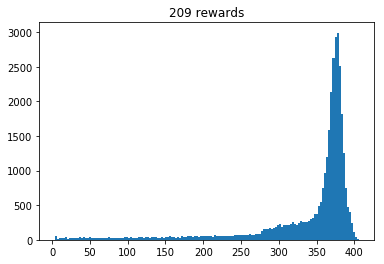

In [30]:
plt.hist([s[-2] for s in constraints], bins='auto')  # arguments are passed to np.histogram
plt.title("209 rewards")
plt.show()

34522


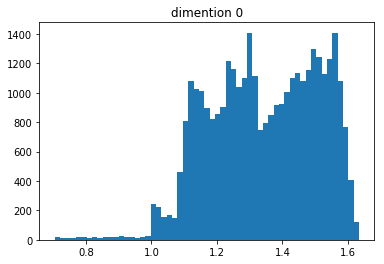

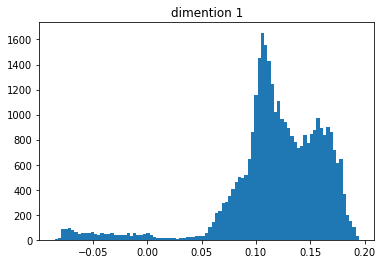

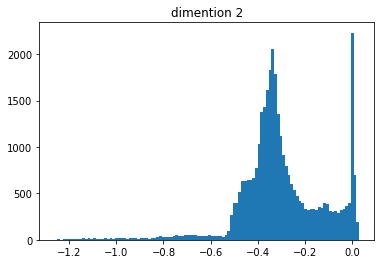

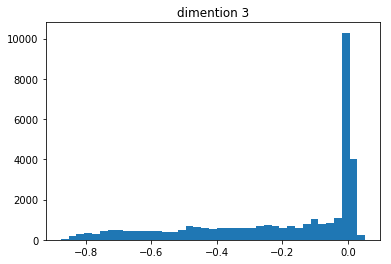

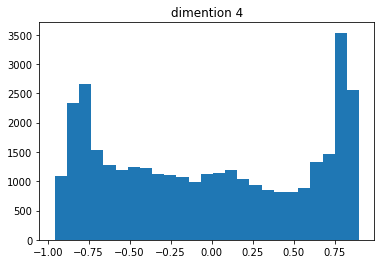

...

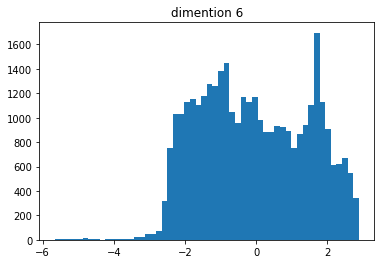

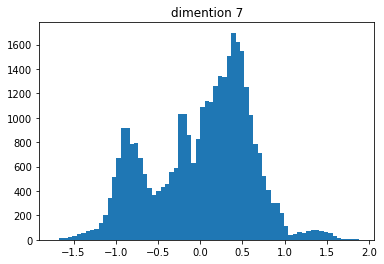

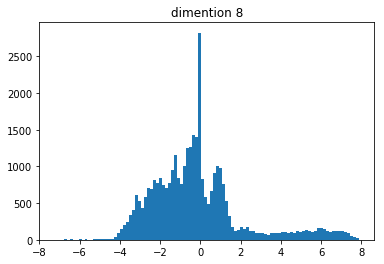

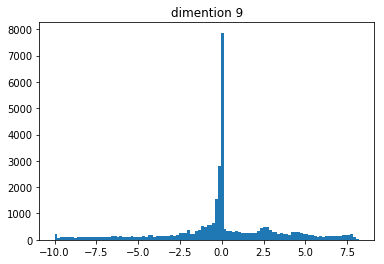

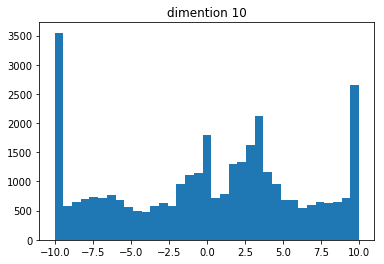

In [21]:
states = [c[0] for c in constraints]
for i in range(11):
    plt.hist([s[i] for s in states], bins='auto')  # arguments are passed to np.histogram
    plt.title("dimention "+str(i))
    plt.show()

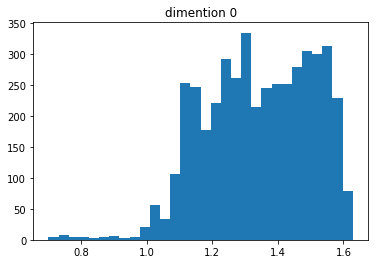

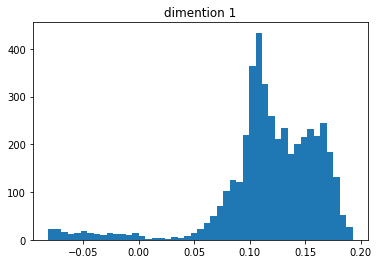

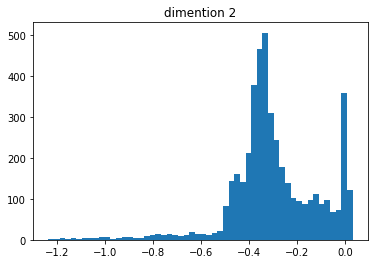

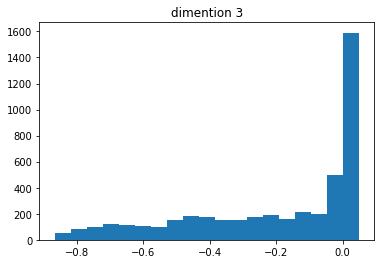

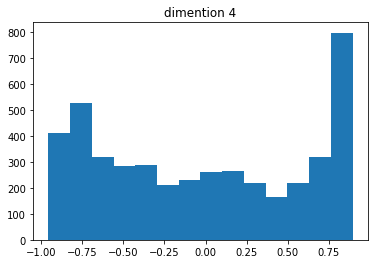

...

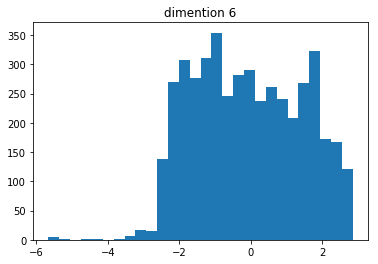

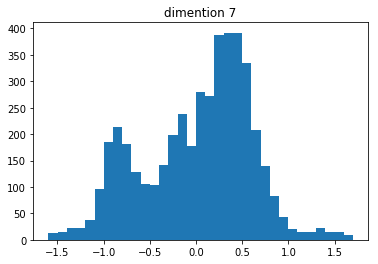

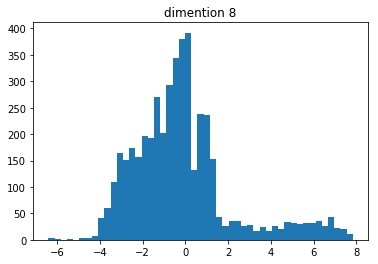

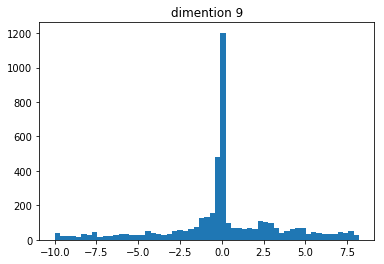

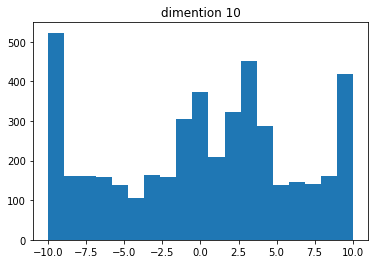

In [8]:
states = [c[0] for c in constraints30]
for i in range(11):
    plt.hist([s[i] for s in states], bins='auto')  # arguments are passed to np.histogram
    plt.title("dimention "+str(i))
    plt.show()

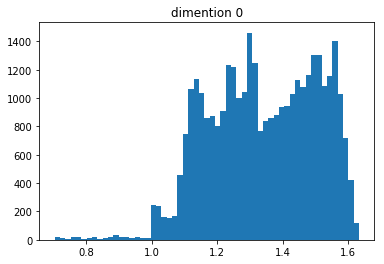

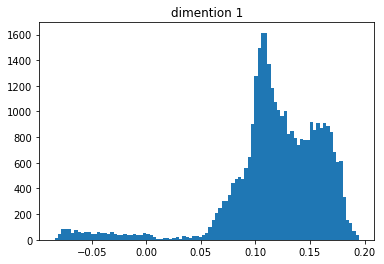

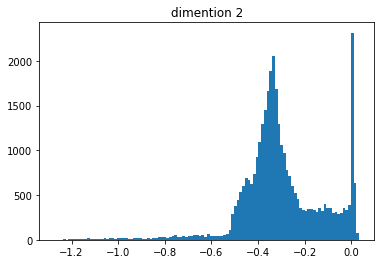

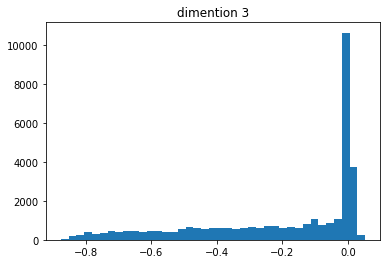

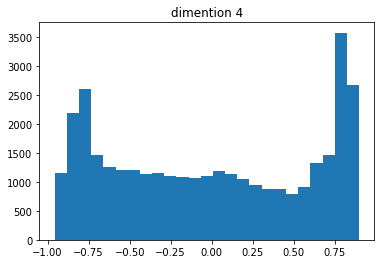

...

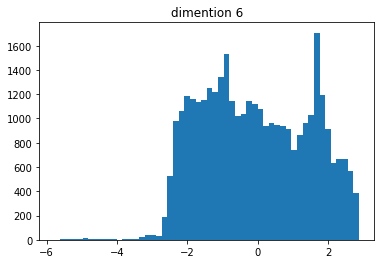

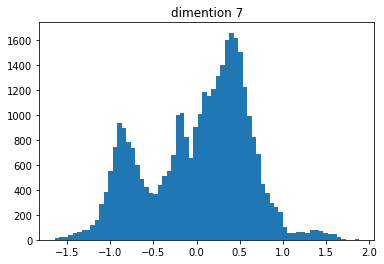

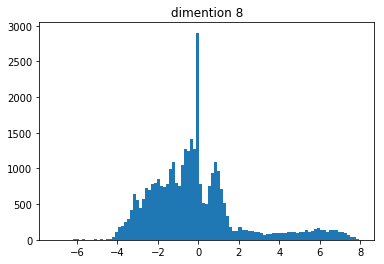

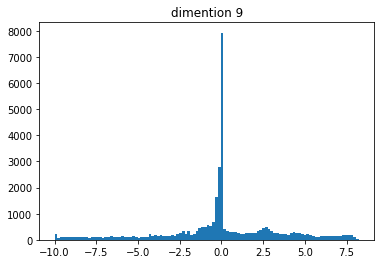

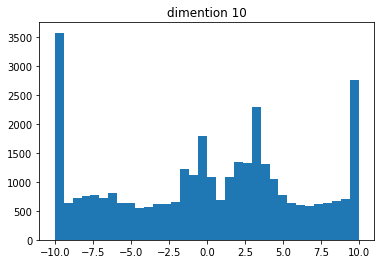

In [31]:

states = [c[0] for c in constraints210]
for i in range(11):
    plt.hist([s[i] for s in states], bins='auto')  # arguments are passed to np.histogram
    plt.title("dimention "+str(i))
    plt.show()

In [10]:
path = "results/Hopper-v2/imitation-test-08_04_04_32/10_"
env = gym.make('Hopper-v2')
constraints30 = pickle.load( open( path+"constraints.p", "rb" ))
#model = load_policy(path+"policy.p", env)

In [ ]:
for i in range(5):
    print(play(model, env))

In [ ]:
frames_1000 = getframes(model, env)
display_frames_as_gif(frames_1000, name="hopper3000")

In [ ]:
from pyglet.window import Window
from pyglet.gl import Config;
w = Window(config=Config(major_version=4, minor_version=1))
print('{}.{}'.format(w.context.config.major_version, w.context.config.minor_version))

In [ ]:
import gym
import time
env = gym.make('Pong-v0')
env.reset()

x = env.render(mode = 'rgb_array')
env.step(env.action_space.sample())

env.close()

print(x)

Policy trianing: epoch 0, loss = 0.071
Policy trianing: epoch 100, loss = 0.007
Policy trianing: epoch 200, loss = 0.007
Policy trianing: epoch 300, loss = 0.006
Policy trianing: epoch 400, loss = 0.006



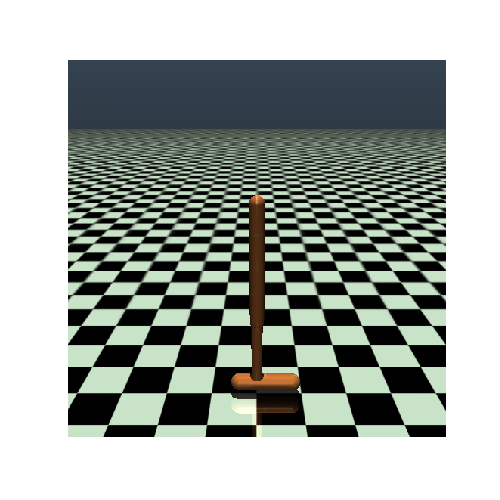
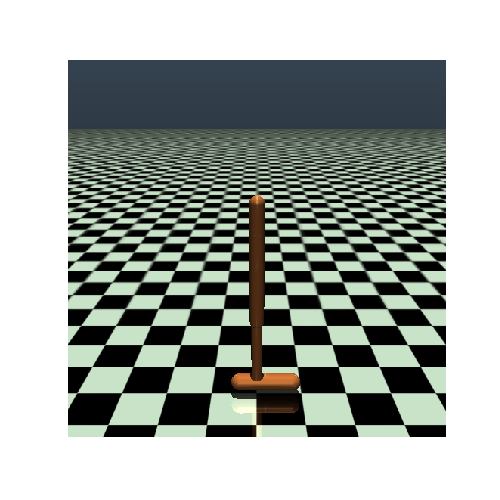
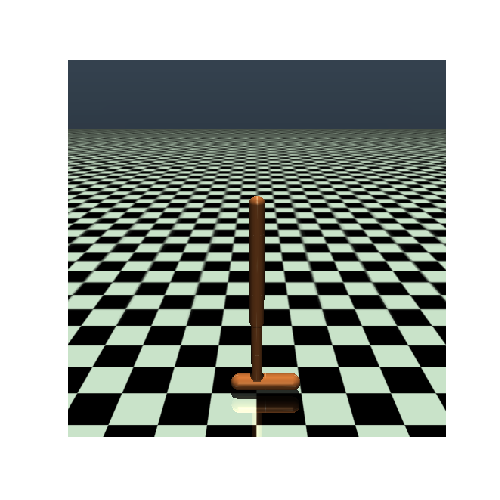
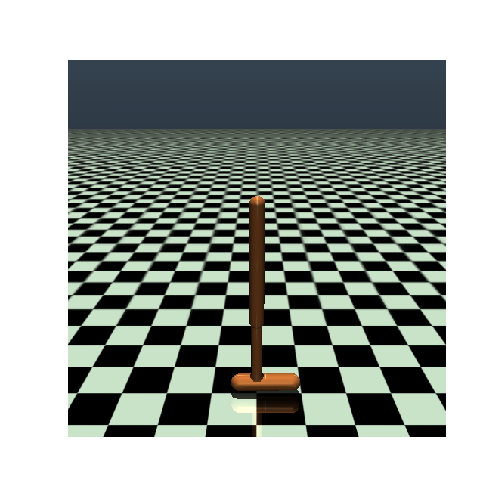
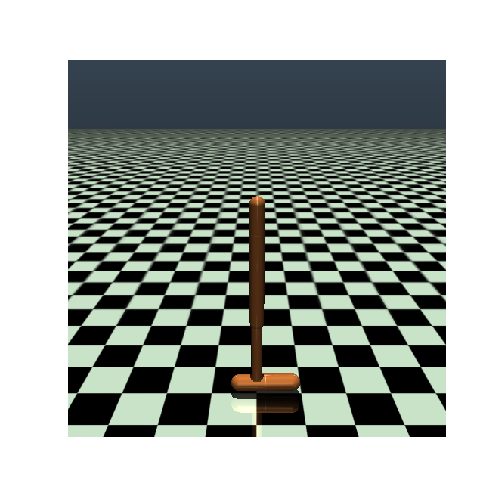
...
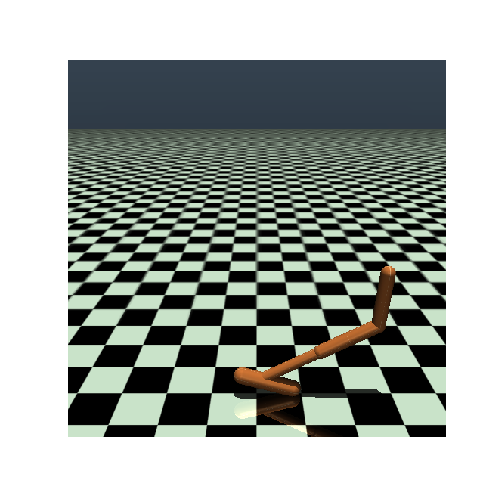
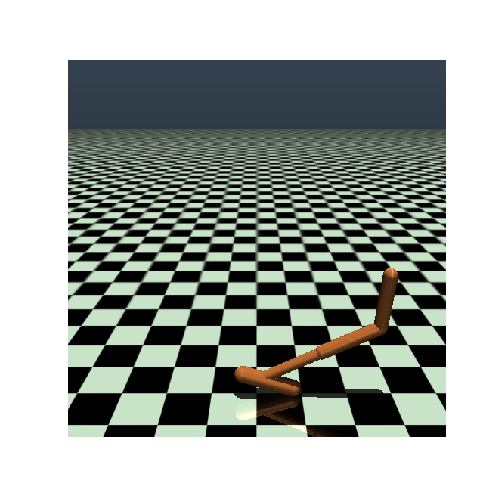
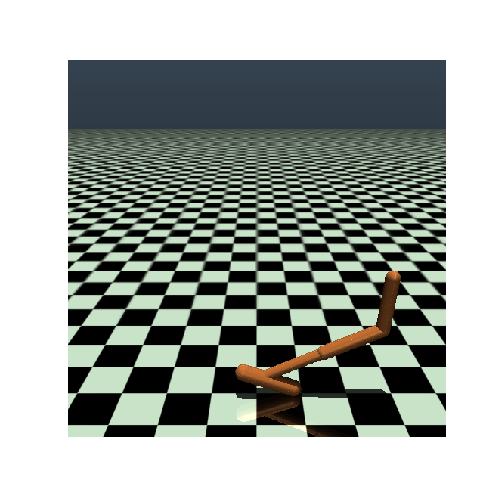
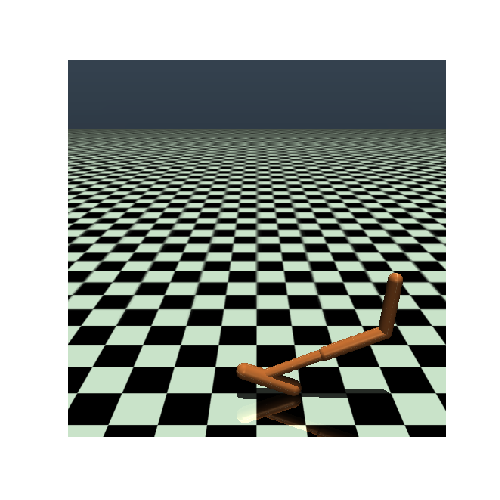
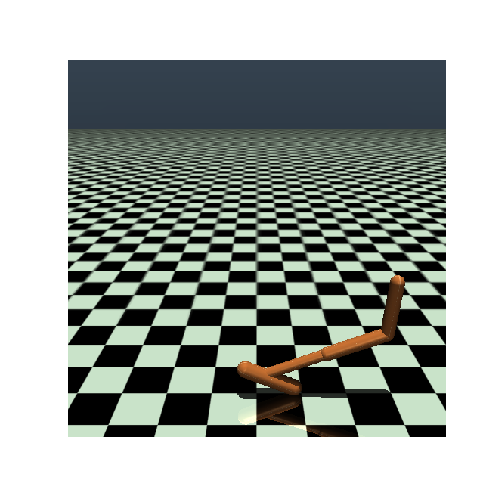

In [11]:
path = "results/Hopper-v2/05_16_20_25/"
env = gym.make('Hopper-v2')
policy_1000 = get_train_policy(path,env)
frames_1000 = getframes(policy_1000, env)
display_frames_as_gif(frames_1000, name="hopper1000-2")

In [ ]:
path = "results/Hopper-v2/05_16_03_08/"
env = gym.make('Hopper-v2')
policy_1000 = get_train_policy(path,env)
frames_1000 = getframes(policy, env)
display_frames_as_gif(frames_1000)


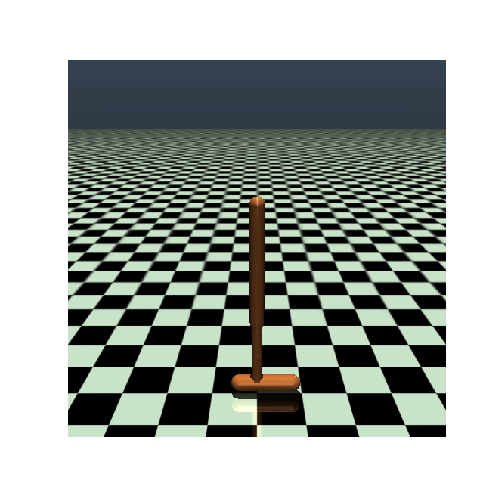
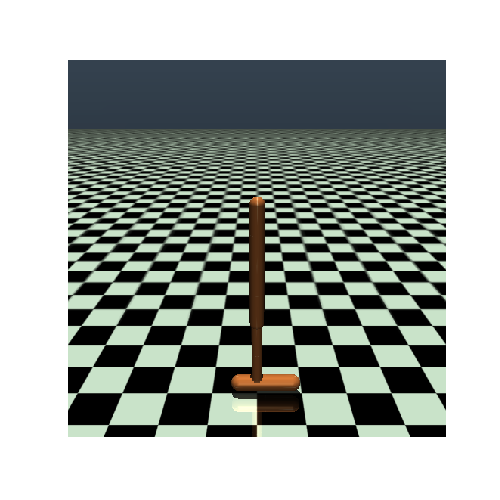
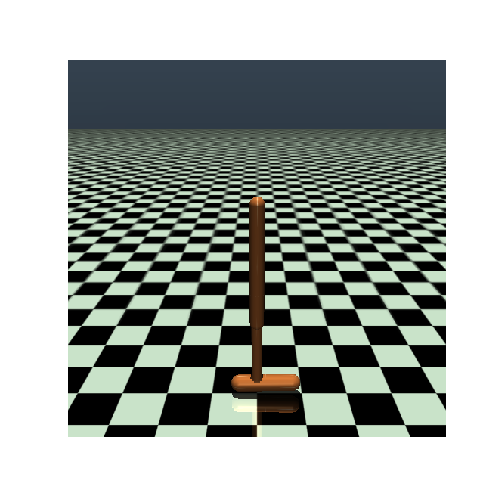
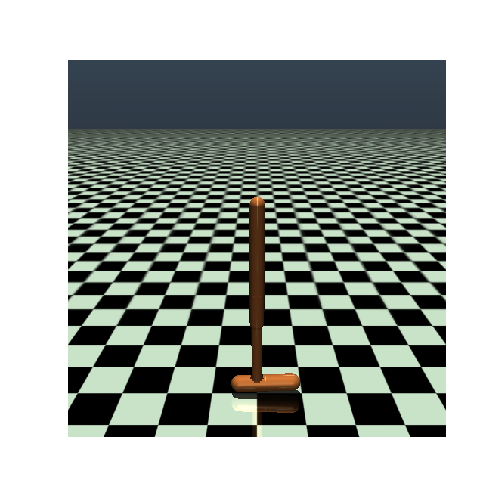
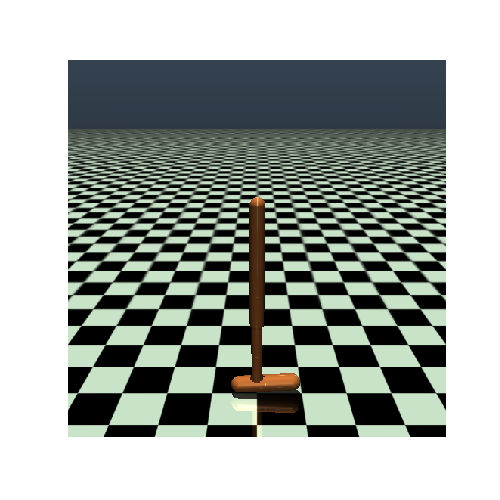
...
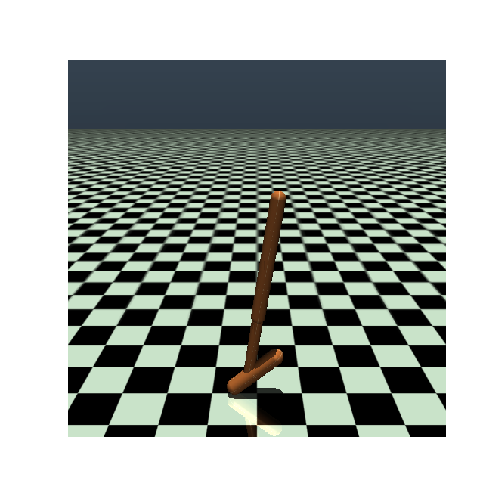
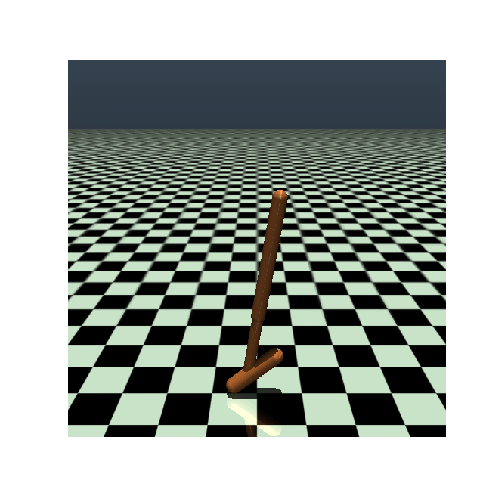
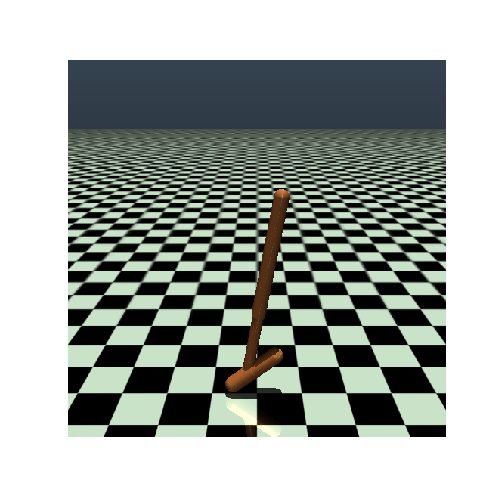
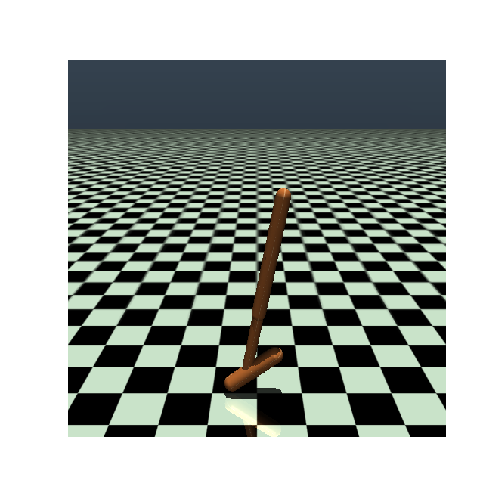
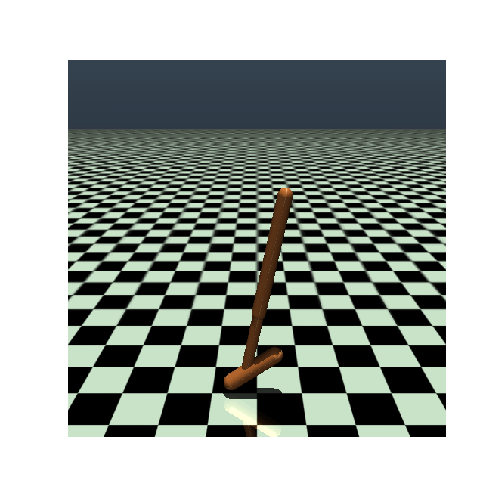

In [28]:
rand = policies.Policy_quad(env.observation_space.shape[0], env.action_space.shape[0]) #random
frames_rand = getframes(rand, env)
display_frames_as_gif(frames_rand)

Using device: cuda:0
Policy trianing: epoch 0, loss = 0.478
Policy trianing: epoch 100, loss = 0.054
Policy trianing: epoch 200, loss = 0.037
Policy trianing: epoch 300, loss = 0.031
Policy trianing: epoch 400, loss = 0.029
Policy trianing: epoch 500, loss = 0.029
Policy trianing: epoch 600, loss = 0.028
Policy trianing: epoch 700, loss = 0.028
Policy trianing: epoch 800, loss = 0.028
Policy trianing: epoch 900, loss = 0.028
Policy trianing: epoch 1000, loss = 0.027
Policy trianing: epoch 1100, loss = 0.028
Policy trianing: epoch 1200, loss = 0.028
Policy trianing: epoch 1300, loss = 0.027
Policy trianing: epoch 1400, loss = 0.028
Policy trianing: epoch 1500, loss = 0.027
Policy trianing: epoch 1600, loss = 0.027
Policy trianing: epoch 1700, loss = 0.026
Policy trianing: epoch 1800, loss = 0.027
Policy trianing: epoch 1900, loss = 0.027
reward: 168.605



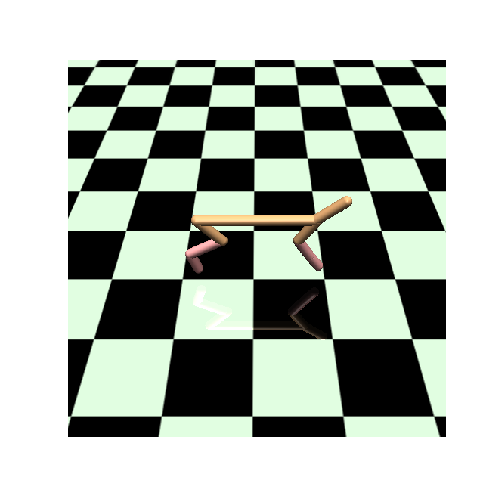
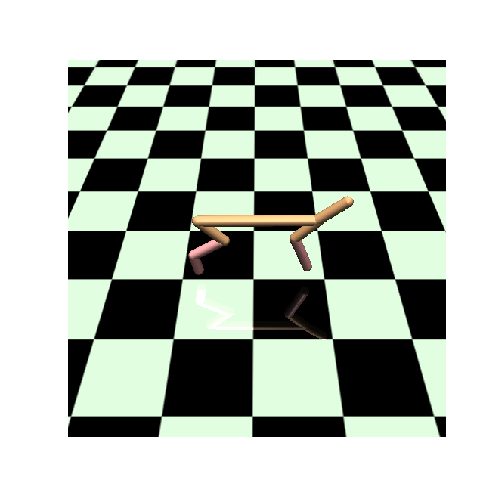
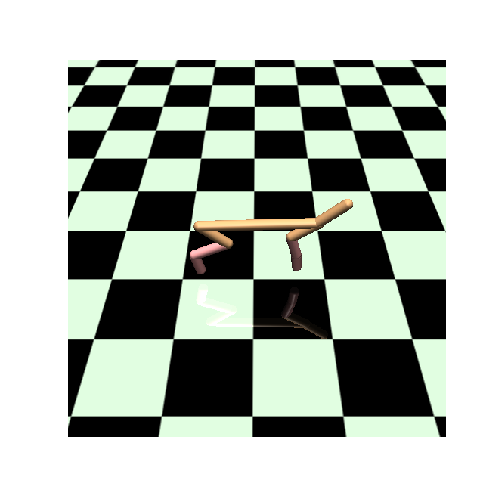
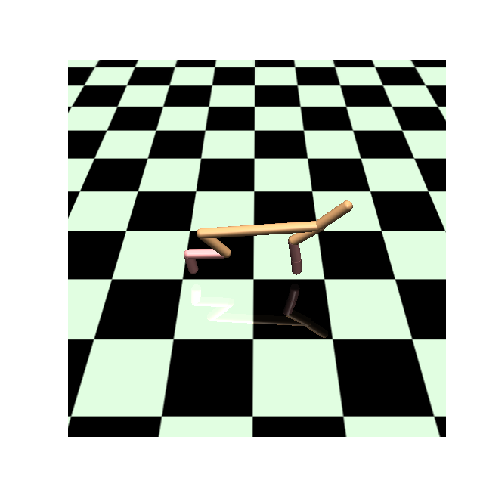
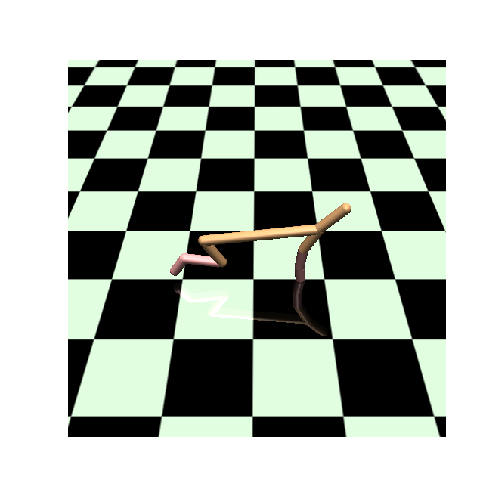
...
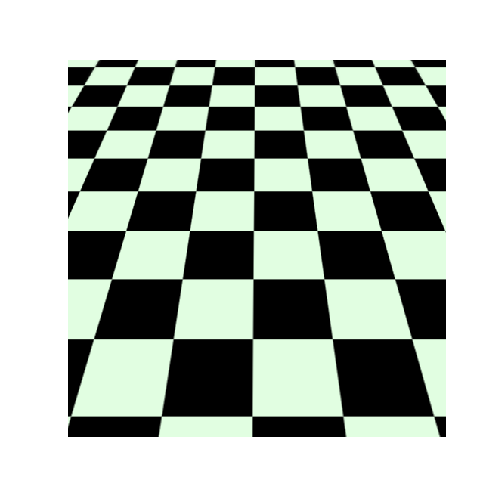
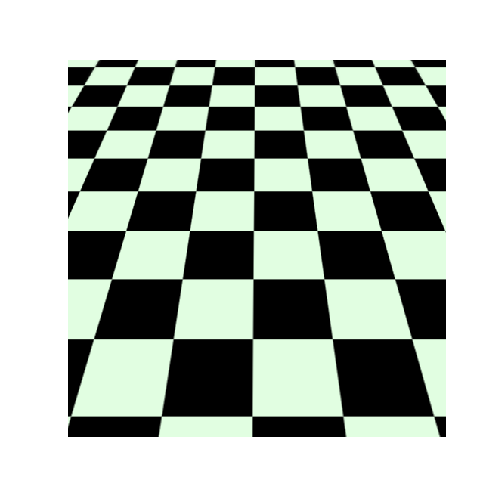
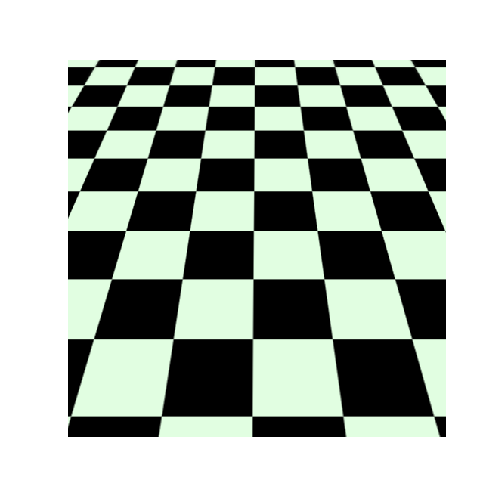
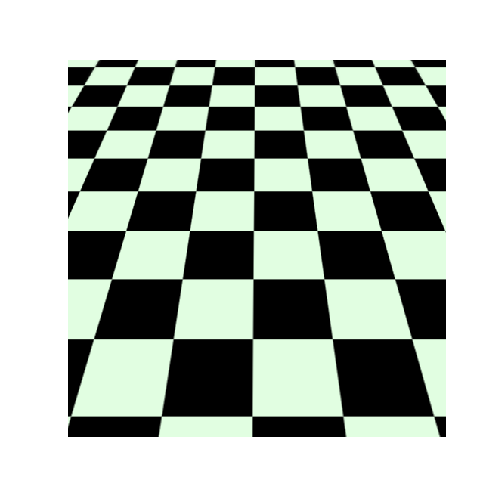
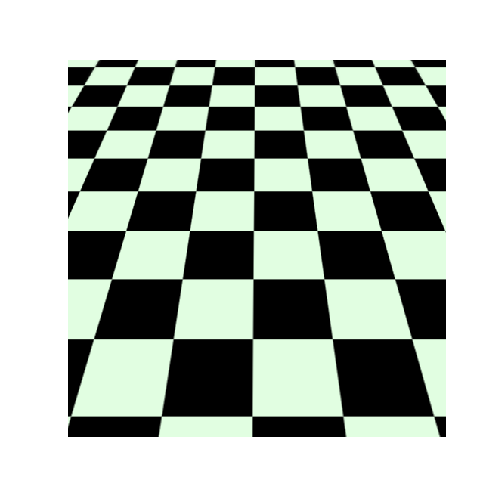

In [48]:
path = "results/HalfCheetah-v2/05_18_00_29/"
env = gym.make('HalfCheetah-v2')
policy_4000 = get_train_policy(path,env,epochs=2000)
frames_4000 = getframes(policy_4000, env, steps=200)
display_frames_as_gif(frames_4000, name="cheetah2300")

Policy trianing: epoch 0, loss = 0.795
Policy trianing: epoch 100, loss = 0.232
Policy trianing: epoch 200, loss = 0.207
Policy trianing: epoch 300, loss = 0.221
Policy trianing: epoch 400, loss = 0.223



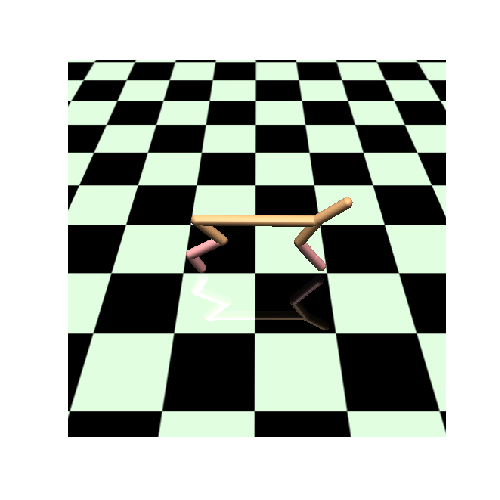
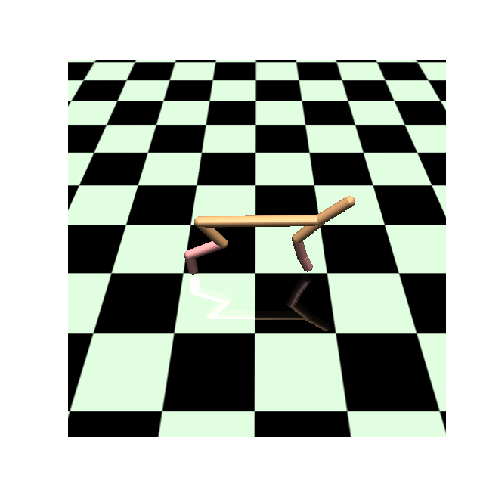
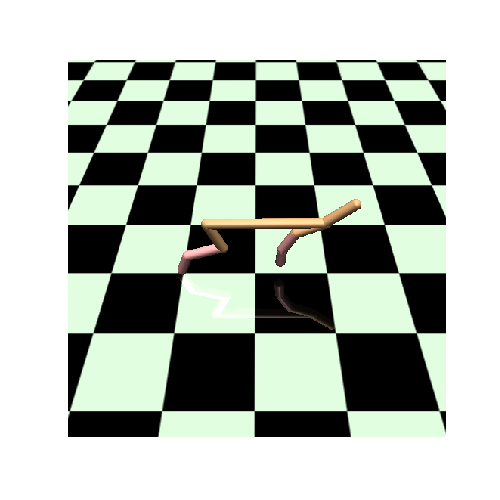
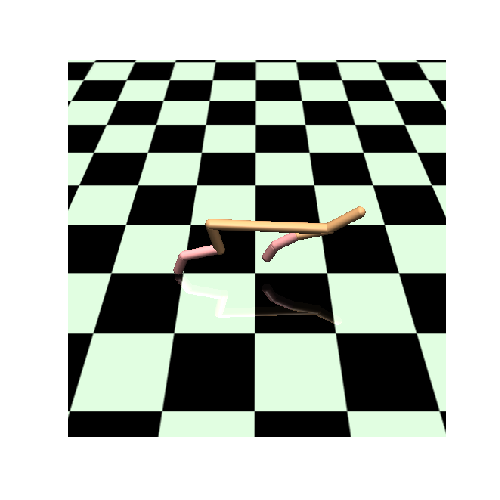
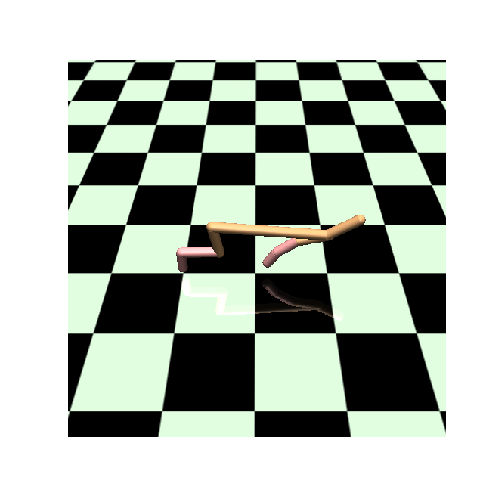
...
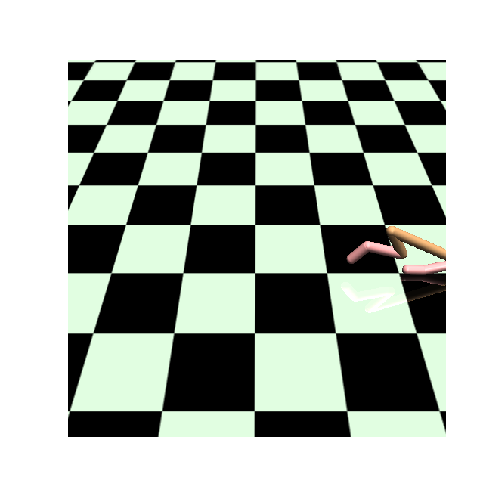
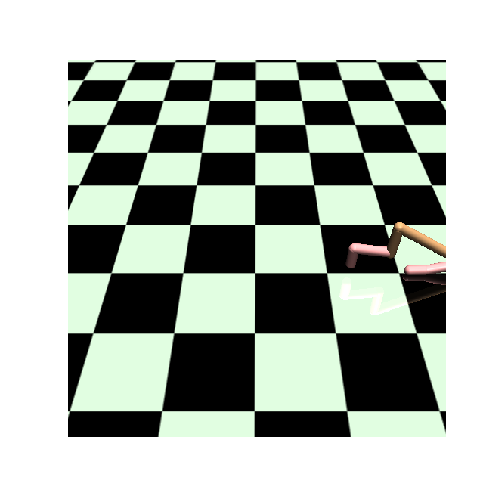
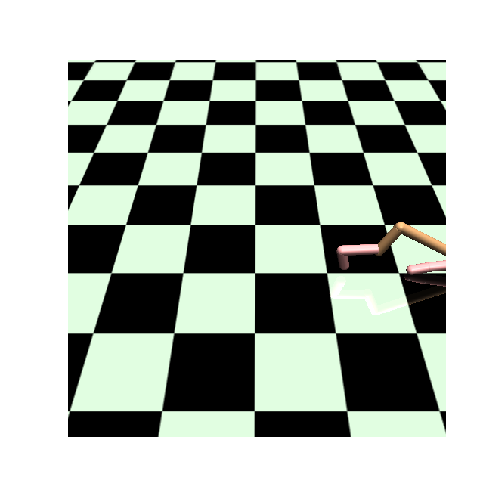
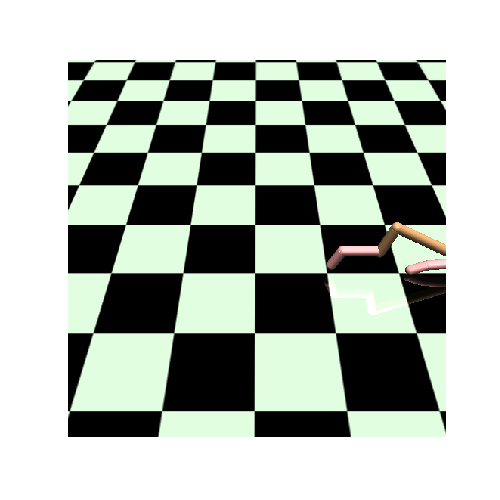
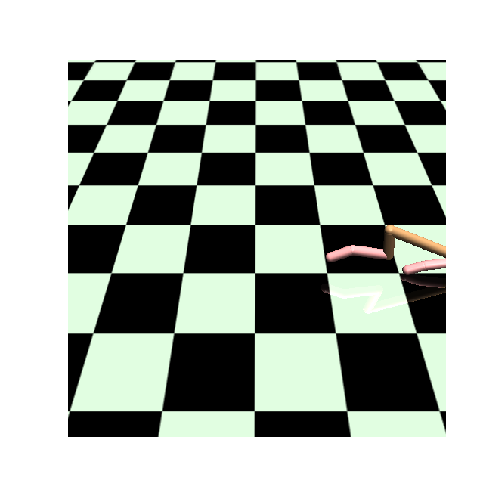

In [9]:
path = "results/HalfCheetah-v2/05_16_02_45/"
env = gym.make('HalfCheetah-v2')
policy_1700 = get_train_policy(path,env)
frames_1700 = getframes(policy_1700, env,steps=200)
display_frames_as_gif(frames_1700, name="cheetah1700")

Policy trianing: epoch 0, loss = 0.029
Policy trianing: epoch 100, loss = 0.006
Policy trianing: epoch 200, loss = 0.006
Policy trianing: epoch 300, loss = 0.006
Policy trianing: epoch 400, loss = 0.006



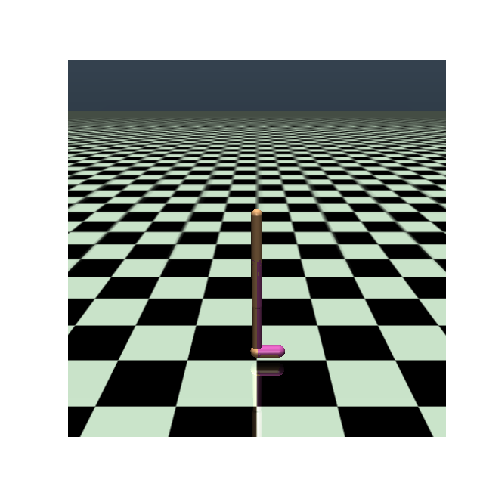
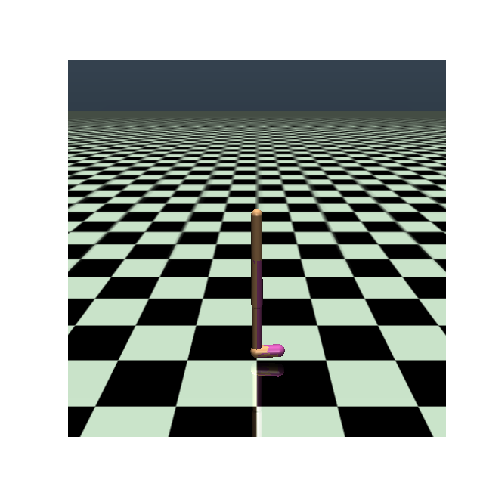
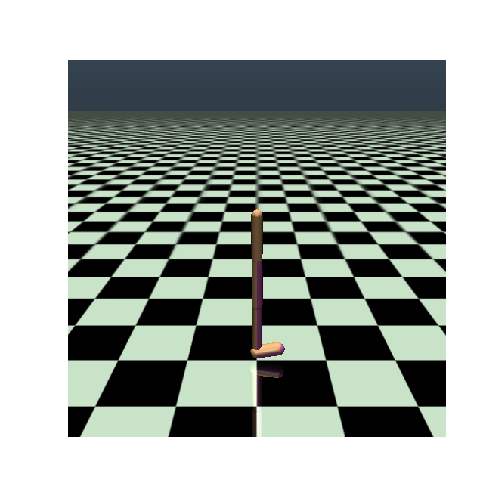
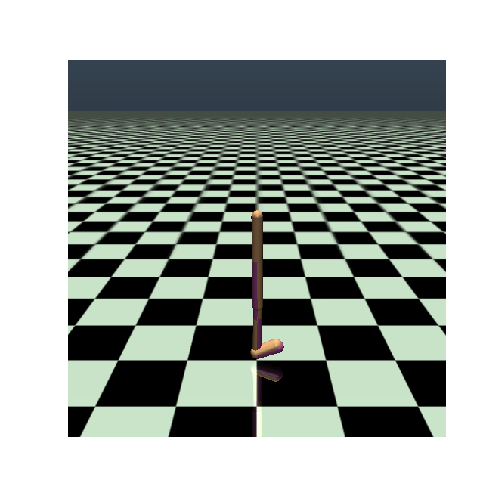
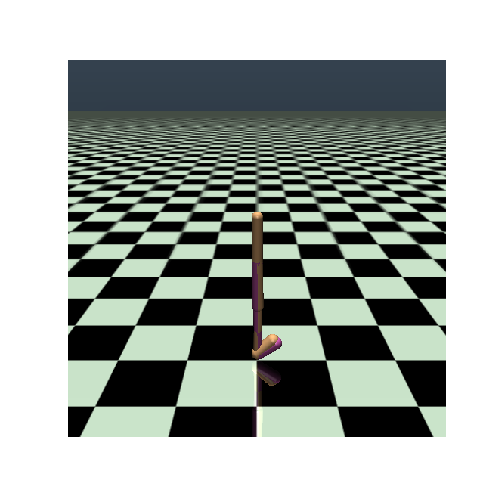
...
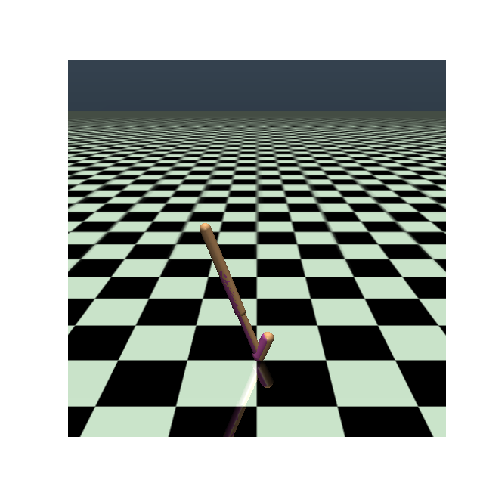
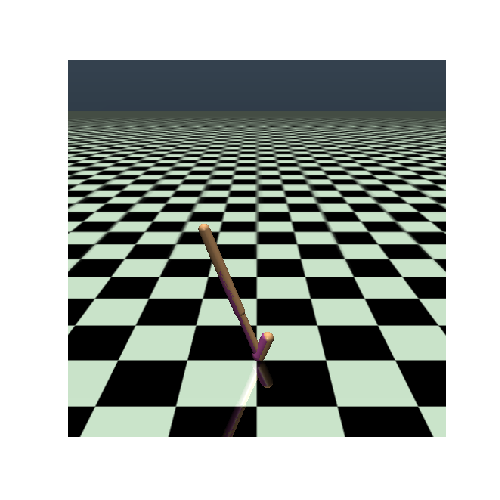
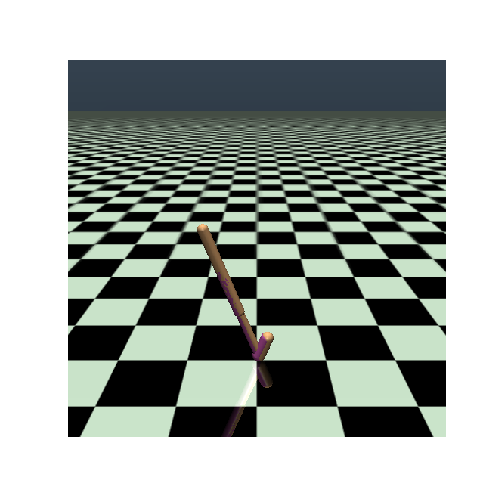
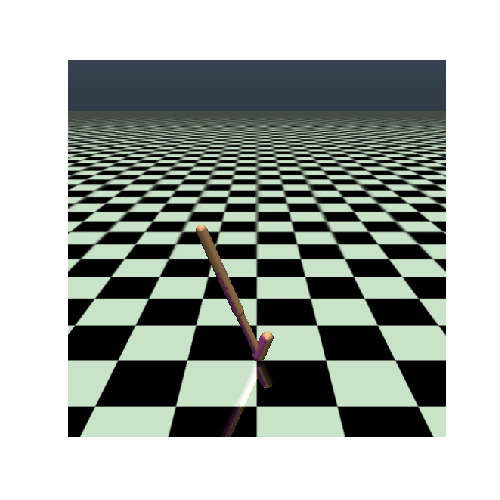
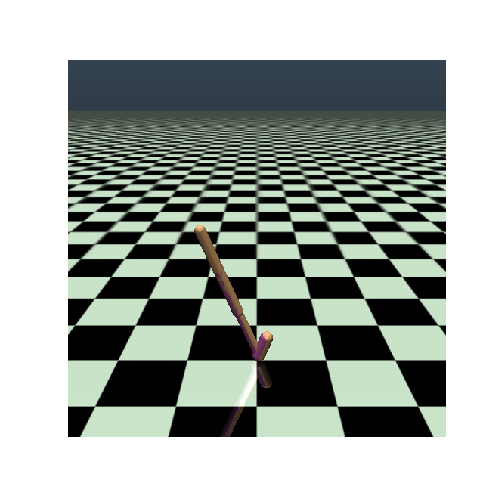

In [14]:
path = "results/Walker2d-v2/05_16_06_14/"
env = gym.make('Walker2d-v2')
policy_1700 = get_train_policy(path,env)
frames_1700 = getframes(policy_1700, env,steps=200)
display_frames_as_gif(frames_1700, name="walker1000")